In [34]:
import pandas as pd
import shap
import xgboost as xgb
import pickle

shap.initjs()

header = ["energies","78_369","78_394","80_467","26_249","26_426","78_399","78_467","79_369","143_205","27_419","27_400","25_469","27_426","77_468","79_467","42_399","42_419","23_187","26_248","27_424","42_398","80_468","143_209","25_249","47_469","78_465","42_421","77_467","23_188","142_209","24_188","79_368","82_468","23_469","26_252","49_188","24_249","26_251","27_418","47_468","49_187","50_187","25_247","26_402","27_417","42_400","25_248","50_185","80_212","26_250","26_417","42_397","78_473","25_188","30_468","142_212","23_247","42_420","26_414","27_425","49_185","50_186","78_466","106_585","142_205","26_400","27_249","47_205","51_209","143_206","143_468","78CA_369CA","78CA_394CA","80CA_467CA","26CA_249CA","26CA_426CA","78CA_399CA","78CA_467CA","79CA_369CA","143CA_205CA","27CA_419CA","27CA_400CA","25CA_469CA","27CA_426CA","77CA_468CA","79CA_467CA","42CA_399CA","42CA_419CA","23CA_187CA","26CA_248CA","27CA_424CA","42CA_398CA","80CA_468CA","143CA_209CA","25CA_249CA","47CA_469CA","78CA_465CA","42CA_421CA","77CA_467CA","23CA_188CA","142CA_209CA","24CA_188CA","82CA_468CA","23CA_469CA","79CA_368CA","26CA_252CA","49CA_188CA","24CA_249CA","26CA_251CA","26CA_402CA","27CA_418CA","47CA_468CA","49CA_187CA","50CA_187CA","25CA_247CA","27CA_417CA","42CA_400CA","25CA_248CA","50CA_185CA","26CA_417CA","26CA_250CA","42CA_397CA","78CA_473CA","25CA_188CA","30CA_468CA","80CA_212CA","142CA_212CA","23CA_247CA","42CA_420CA","26CA_414CA","27CA_425CA","49CA_185CA","50CA_186CA","78CA_466CA","142CA_205CA","26CA_400CA","27CA_249CA","47CA_205CA","51CA_209CA","80CA_205CA","143CA_206CA","143CA_468CA","phi:23","psi:23","chip:23","phi:24","psi:24","phi:25","psi:25","chip:25","phi:26","psi:26","chip:26","phi:27","psi:27","chip:27","phi:30","psi:30","chip:30","phi:42","psi:42","chip:42","phi:47","psi:47","chip:47","phi:49","psi:49","chip:49","phi:50","psi:50","phi:51","psi:51","chip:51","phi:77","psi:77","phi:78","psi:78","chip:78","phi:79","psi:79","chip:79","phi:80","psi:80","phi:82","psi:82","chip:82","phi:142","psi:142","chip:142","phi:143","psi:143","chip:143","phi:185","psi:185","phi:186","psi:186","phi:187","psi:187","phi:188","psi:188","chip:188","phi:205","psi:205","chip:205","phi:206","psi:206","phi:209","psi:209","phi:212","psi:212","phi:247","psi:247","chip:247","phi:248","psi:248","phi:249","psi:249","phi:250","psi:250","phi:251","psi:251","phi:252","psi:252","psi:368","chip:368","phi:369","psi:369","phi:394","psi:394","chip:394","phi:397","psi:397","phi:398","psi:398","chip:398","phi:399","psi:399","chip:399","phi:400","psi:400","chip:400","phi:402","psi:402","chip:402","phi:414","psi:414","chip:414","phi:417","psi:417","phi:418","psi:418","chip:418","phi:419","psi:419","chip:419","phi:420","psi:420","chip:420","phi:421","psi:421","chip:421","phi:424","psi:424","chip:424","phi:425","psi:425","phi:426","psi:426","phi:465","psi:465","phi:466","psi:466","chip:466","phi:467","psi:467","chip:467","phi:468","psi:468","chip:468","phi:469","psi:469","chip:469","phi:473","psi:473"
    ]
train_data = pd.read_csv('train_all', names=header, sep=',', index_col=False, nrows=1000)

y = train_data.iloc[:,0]
X = train_data.iloc[:,1:]

# feature_perturbation="tree_path_dependent" to make output/analysis indepentdent of data
model = pickle.load(open("xgboost-model-bm25_exR2220R2215", "rb"))
explainer = shap.TreeExplainer(model, feature_perturbation="tree_path_dependent", model_output='raw')
#shap_values = explainer.shap_values(X)


# visualize the first prediction's explanation (use matplotlib=True to avoid Javascript)
#shap.force_plot(explainer.expected_value, shap_values[0,:], X.iloc[0,:])


In [35]:
shap_values = explainer.shap_values(train_data)

In [36]:
shap.force_plot(explainer.expected_value, shap_values, train_data)

In [ ]:
shap.dependence_plot("47_469", shap_values, X)

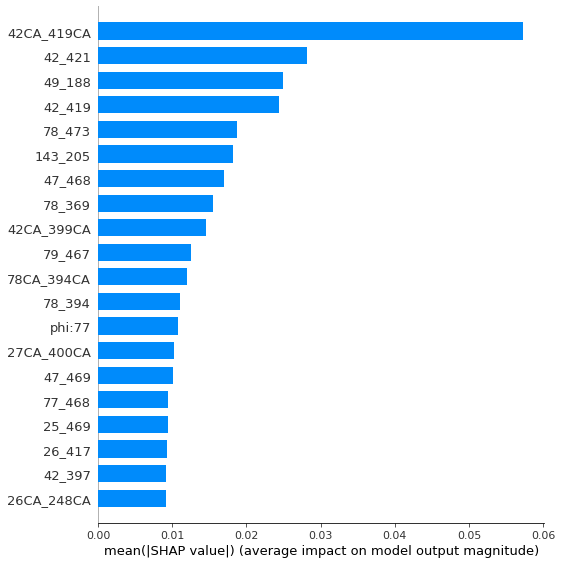

In [37]:
shap.summary_plot(shap_values, train_data, plot_type="bar")

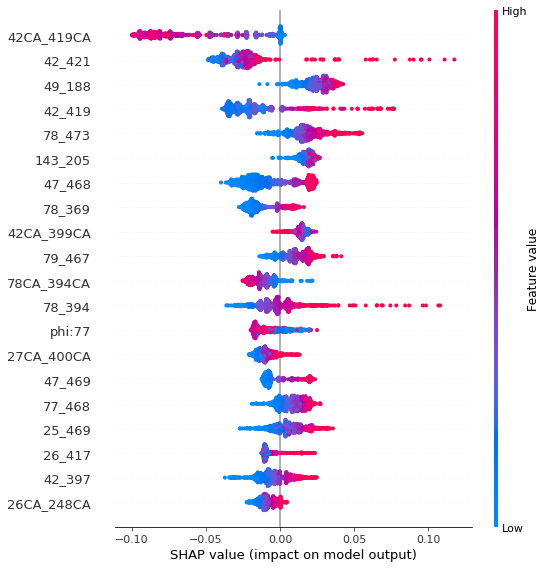

In [38]:
shap.summary_plot(shap_values, train_data)

In [41]:
shap.force_plot(explainer.expected_value, shap_values[320,:], train_data.iloc[320,:])